In [1]:
import torch
from torch import nn
import zipfile
from torch.utils.data import DataLoader, Subset
from torchvision import transforms
from torchvision.datasets import ImageFolder
import matplotlib.pyplot as plt
import os
from torchvision.utils import make_grid, save_image
import random


In [2]:
with zipfile.ZipFile('/Users/navalmor/Desktop/deeplearning/data/anime/archive.zip', 'r') as zip_ref:
    zip_ref.extractall('/Users/navalmor/Desktop/deeplearning/data/anime/anime_images')

In [3]:
transform = transforms.Compose([
    transforms.Resize((64, 64)),
    transforms.CenterCrop(64),
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
])

def denorm(images):
    return images * 0.5 + 0.5

In [4]:
train_data = ImageFolder(root='/Users/navalmor/Desktop/deeplearning/data/anime',
                         transform=transform)

len(train_data)

63565

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


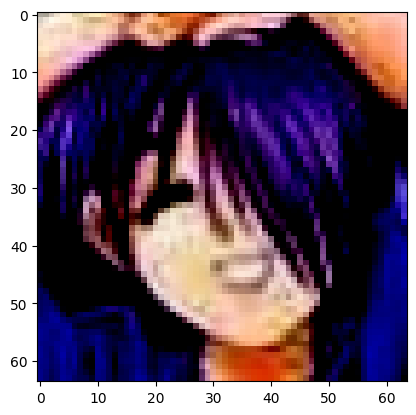

In [5]:
plt.imshow(train_data[0][0].detach().permute(1,2,0))

In [6]:
batch_size = 64

subset = random.sample(range(len(train_data)), 3200)

subset_data = Subset(train_data, subset)

train_dataloader = DataLoader(dataset=subset_data,
                              batch_size=batch_size, shuffle=True)
len(train_dataloader)

50

In [7]:
def show_images(images, nmax=64):
    fig, ax = plt.subplots(figsize=(8, 8))
    ax.set_xticks([]); ax.set_yticks([])
    ax.imshow(make_grid(denorm(images.detach()[:nmax]), nrow=8).permute(1,2,0))

def show_batch(dataloader, nmax=64):
    for img,_ in dataloader:
        show_images(img)
        break

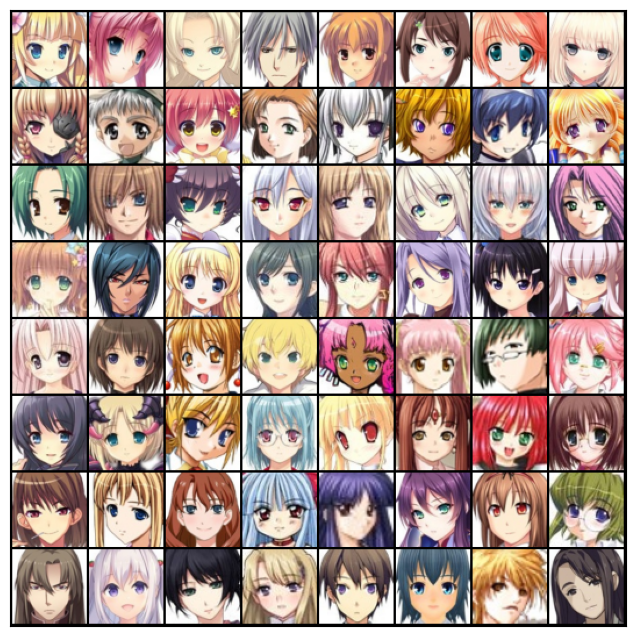

In [8]:
show_batch(train_dataloader)

In [9]:
discriminator = nn.Sequential(
                nn.Conv2d(in_channels=3, out_channels=64, kernel_size=4, stride=2, padding=1, bias=False),
                nn.BatchNorm2d(64),
                nn.LeakyReLU(inplace=True),

                nn.Conv2d(in_channels=64, out_channels=128, kernel_size=4, stride=2, padding=1, bias=False),
                nn.BatchNorm2d(128),
                nn.LeakyReLU(inplace=True),

                nn.Conv2d(in_channels=128, out_channels=256, kernel_size=4, stride=2, padding=1, bias=False),
                nn.BatchNorm2d(256),
                nn.LeakyReLU(inplace=True),

                nn.Conv2d(in_channels=256, out_channels=512, kernel_size=4, stride=2, padding=1, bias=False),
                nn.BatchNorm2d(512),
                nn.LeakyReLU(inplace=True),

                nn.Conv2d(in_channels=512, out_channels=1, kernel_size=4, stride=1, padding=0, bias=False),                
                nn.Flatten(),
                nn.Sigmoid()
        )


generator = nn.Sequential(
            nn.ConvTranspose2d(in_channels=256, out_channels=512, kernel_size=4, stride=1, padding=0, bias=False),
            nn.BatchNorm2d(512),
            nn.ReLU(True),

            nn.ConvTranspose2d(in_channels=512, out_channels=256, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(256),
            nn.ReLU(True),

            nn.ConvTranspose2d(in_channels=256, out_channels=128, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(128),
            nn.ReLU(True),

            nn.ConvTranspose2d(in_channels=128, out_channels=64, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(64),
            nn.ReLU(True),

            nn.ConvTranspose2d(in_channels=64, out_channels=3, kernel_size=4, stride=2, padding=1, bias=False),
            nn.Tanh()
        )

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([[[[-0.2449,  0.0210, -0.4688,  ..., -0.0378, -0.1346,  0.0063],
          [-0.5154, -0.5269, -0.3268,  ...,  0.0364, -0.4341,  0.1267],
          [-0.1099, -0.0180,  0.4169,  ...,  0.4080,  0.0464, -0.1231],
          ...,
          [-0.0744, -0.1531,  0.0315,  ..., -0.7176,  0.1531,  0.1283],
          [-0.0347, -0.4362,  0.3721,  ...,  0.5509,  0.6856, -0.2745],
          [-0.1584,  0.1603, -0.1619,  ...,  0.0212, -0.1643,  0.2065]],

         [[-0.4165, -0.2619, -0.4729,  ..., -0.5126, -0.5544, -0.0597],
          [ 0.2721, -0.1493,  0.6306,  ...,  0.0748,  0.5826,  0.4734],
          [-0.2858, -0.2250, -0.0125,  ..., -0.4715, -0.5729, -0.1175],
          ...,
          [ 0.3484, -0.0019,  0.2850,  ...,  0.1501,  0.1029, -0.0375],
          [-0.1153, -0.4617, -0.4772,  ...,  0.3997, -0.6385, -0.1250],
          [ 0.0171, -0.5120, -0.0336,  ..., -0.1220,  0.1123, -0.2664]],

         [[-0.0618,  0.3423, -0.1417,  ...,  0.3966, -0.0611,  0.1691],
          [-0.0870, -0.2607, -

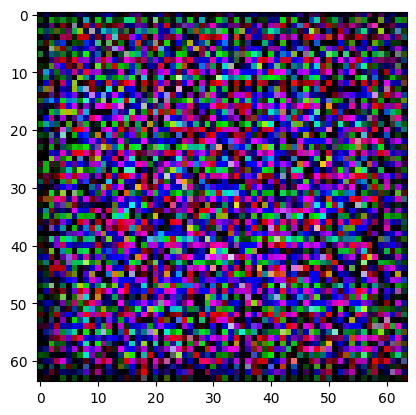

In [10]:
torch.manual_seed(42)
latent = torch.rand(1, 256, 1, 1)
gen = generator(latent)
plt.imshow(gen.detach().squeeze().permute(1,2,0))
#plt.imshow(next(iter(train_dataloader))[0][0].permute(1,2,0))
gen

In [11]:
torch.manual_seed(42)
latent_space = torch.randn((batch_size, 256, 1, 1))
#model = GAN(latent_space=latent_space)

In [12]:
d = discriminator(train_data[0][0].unsqueeze(0))
d

tensor([[0.4902]], grad_fn=<SigmoidBackward0>)

In [13]:
g = generator(latent_space)
g

tensor([[[[-0.2833,  0.1203, -0.2659,  ..., -0.2611, -0.0524,  0.0421],
          [-0.3046, -0.5022, -0.2187,  ..., -0.0987, -0.1356,  0.3169],
          [-0.2134, -0.0638, -0.1168,  ..., -0.0469,  0.7579, -0.1755],
          ...,
          [-0.1100, -0.3772, -0.0858,  ..., -0.5353,  0.5256,  0.1638],
          [ 0.0480,  0.0202,  0.2172,  ...,  0.0772,  0.7372, -0.3128],
          [-0.0903,  0.2223, -0.0551,  ...,  0.1085, -0.0502,  0.2232]],

         [[-0.3925, -0.3430, -0.2493,  ..., -0.2873, -0.5567, -0.1597],
          [ 0.1780, -0.1413,  0.8445,  ..., -0.1635,  0.4137,  0.1243],
          [-0.3204,  0.0686, -0.2083,  ..., -0.0373,  0.3226, -0.0379],
          ...,
          [ 0.2439, -0.6752,  0.5695,  ..., -0.5639,  0.6399, -0.1482],
          [-0.1126, -0.0616, -0.6084,  ..., -0.2741, -0.5721, -0.3137],
          [ 0.0971, -0.3578, -0.1454,  ..., -0.0744,  0.2718, -0.1569]],

         [[-0.0781,  0.4481, -0.1540,  ...,  0.3520,  0.0826,  0.2314],
          [-0.0041, -0.2822,  

In [14]:
def save_images(index, latent_space, show=True):
    fake_images = generator(latent_space)
    fake_fname = f'generated-images-{index}.jpg'
    save_image(denorm(fake_images), os.path.join('/Users/navalmor/Desktop/deeplearning/data/generated', fake_fname), nrow=8)
    if show:
        fig, ax = plt.subplots(figsize=(8, 8))
        ax.set_xticks([]); ax.set_yticks([])
        ax.imshow(make_grid(fake_images.detach(), nrow=8).permute(1,2,0))

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


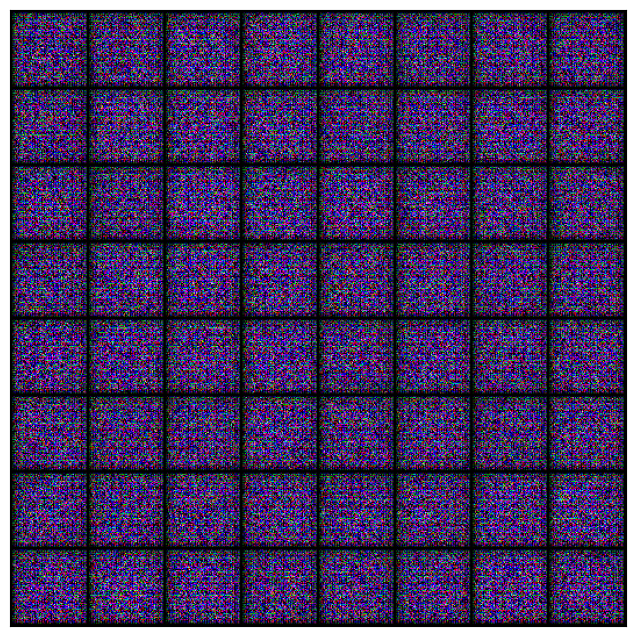

In [15]:
save_images(0000, latent_space)

In [16]:
def train_discriminator(data,
                        latent_space,
                        optimizer :torch.optim,
                        loss_fn :nn.functional):
        discriminator_loss = 0
        real_score = 0
        fake_score = 0
        for X,_ in data:              
            optimizer.zero_grad()
            real_pred = discriminator(X)
            real_target = torch.ones(batch_size, 1)
            real_loss = loss_fn(real_pred, real_target)
            r_score = torch.mean(real_pred).item()
            real_score += r_score

            fake_images = generator(latent_space)
            fake_pred = discriminator(fake_images)
            fake_target = torch.zeros(batch_size, 1)
            fake_loss = loss_fn(fake_pred, fake_target)
            f_score = torch.mean(fake_pred).item()
            fake_score += f_score

            loss = real_loss + fake_loss
            discriminator_loss += loss

            loss.backward()
            optimizer.step()

        real_score /= len(train_dataloader)
        fake_score /= len(train_dataloader)
        discriminator_loss /= len(train_dataloader)
       #print(f'discriminator_loss : {discriminator_loss :.3f} | real_score : {real_score} | fake_score : {fake_score}')


        return discriminator_loss, real_score, fake_score


def train_generator(data,
                    latent_space,
                    optimizer :torch.optim,
                    loss_fn :nn.functional):
        generator_loss = 0
        for i in range(len(data)):
            optimizer.zero_grad()
            fake_images = generator(latent_space)
            fake_pred = discriminator(fake_images)
            fake_target = torch.ones(batch_size,1)
            loss = loss_fn(fake_pred, fake_target)
            generator_loss += loss

            loss.backward()
            optimizer.step()
            
        generator_loss /= len(data)
        #print(f'generator_loss : {generator_loss}')

        return generator_loss
      



Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch : 0 | discriminator_loss : 0.288 | generator_loss : 0.498 | real_score : 0.912 | fake_score : 0.079


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch : 1 | discriminator_loss : 0.474 | generator_loss : 0.600 | real_score : 0.886 | fake_score : 0.120


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch : 2 | discriminator_loss : 0.433 | generator_loss : 0.533 | real_score : 0.893 | fake_score : 0.109


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch : 3 | discriminator_loss : 0.435 | generator_loss : 0.499 | real_score : 0.896 | fake_score : 0.110


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch : 4 | discriminator_loss : 0.435 | generator_loss : 0.502 | real_score : 0.891 | fake_score : 0.110


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch : 5 | discriminator_loss : 0.436 | generator_loss : 0.513 | real_score : 0.895 | fake_score : 0.108


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch : 6 | discriminator_loss : 0.463 | generator_loss : 0.508 | real_score : 0.891 | fake_score : 0.118


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch : 7 | discriminator_loss : 0.451 | generator_loss : 0.531 | real_score : 0.884 | fake_score : 0.112


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch : 8 | discriminator_loss : 0.460 | generator_loss : 0.530 | real_score : 0.885 | fake_score : 0.121


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch : 9 | discriminator_loss : 0.445 | generator_loss : 0.518 | real_score : 0.883 | fake_score : 0.115


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch : 10 | discriminator_loss : 0.430 | generator_loss : 0.517 | real_score : 0.892 | fake_score : 0.109


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch : 11 | discriminator_loss : 0.416 | generator_loss : 0.474 | real_score : 0.895 | fake_score : 0.107


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch : 12 | discriminator_loss : 0.407 | generator_loss : 0.469 | real_score : 0.894 | fake_score : 0.108


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch : 13 | discriminator_loss : 0.423 | generator_loss : 0.492 | real_score : 0.892 | fake_score : 0.110


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch : 14 | discriminator_loss : 0.426 | generator_loss : 0.507 | real_score : 0.890 | fake_score : 0.111


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch : 15 | discriminator_loss : 0.416 | generator_loss : 0.502 | real_score : 0.890 | fake_score : 0.110


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch : 16 | discriminator_loss : 0.423 | generator_loss : 0.450 | real_score : 0.889 | fake_score : 0.112


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch : 17 | discriminator_loss : 0.425 | generator_loss : 0.471 | real_score : 0.894 | fake_score : 0.113


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch : 18 | discriminator_loss : 0.428 | generator_loss : 0.480 | real_score : 0.888 | fake_score : 0.113


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch : 19 | discriminator_loss : 0.433 | generator_loss : 0.503 | real_score : 0.889 | fake_score : 0.109


/var/folders/xc/5qc2dsm12rl4s8_3vyxlnj4c0000gn/T/ipykernel_47278/463221256.py:6: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(figsize=(8, 8))
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch : 20 | discriminator_loss : 0.419 | generator_loss : 0.528 | real_score : 0.893 | fake_score : 0.113


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch : 21 | discriminator_loss : 0.421 | generator_loss : 0.571 | real_score : 0.888 | fake_score : 0.115


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch : 22 | discriminator_loss : 0.441 | generator_loss : 0.461 | real_score : 0.878 | fake_score : 0.122


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch : 23 | discriminator_loss : 0.394 | generator_loss : 0.473 | real_score : 0.896 | fake_score : 0.103


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch : 24 | discriminator_loss : 0.400 | generator_loss : 0.509 | real_score : 0.897 | fake_score : 0.107


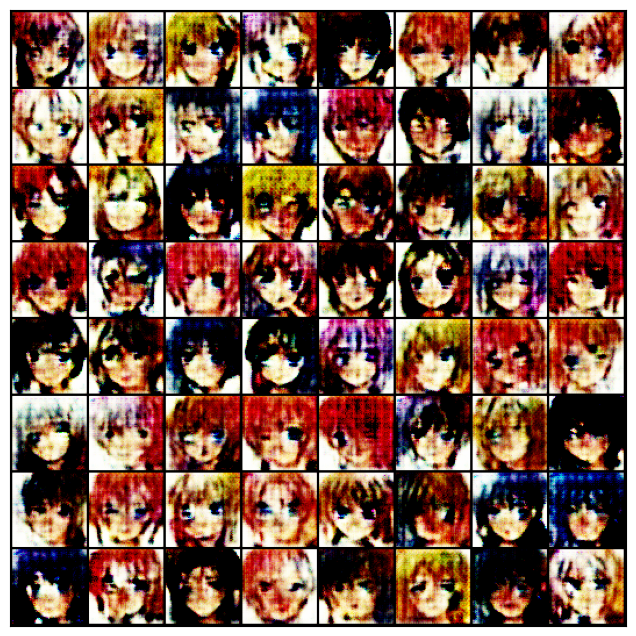

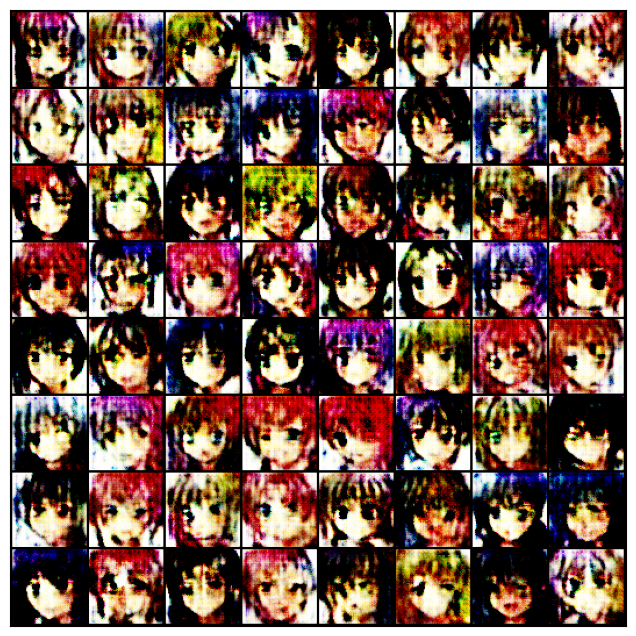

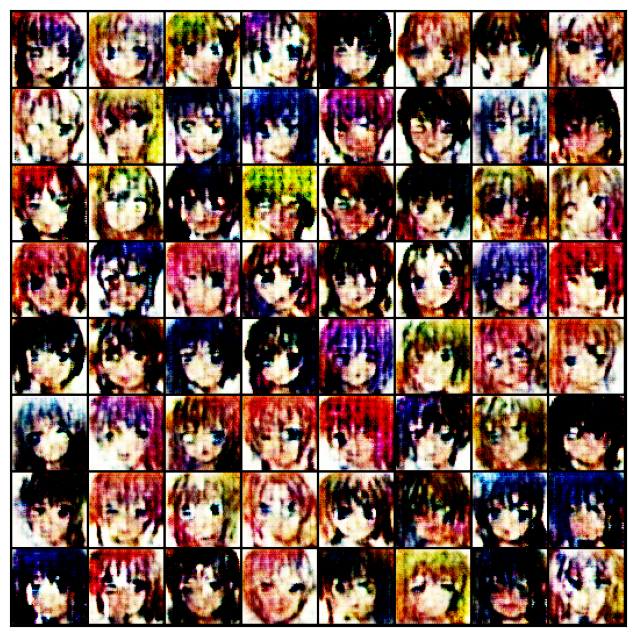

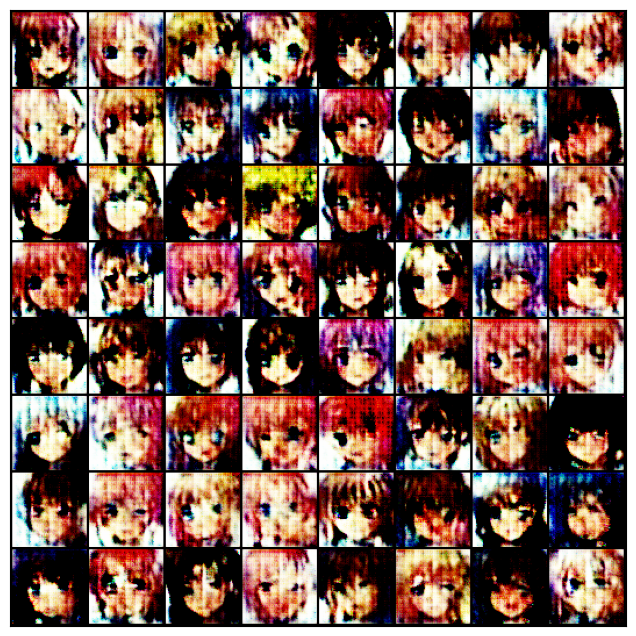

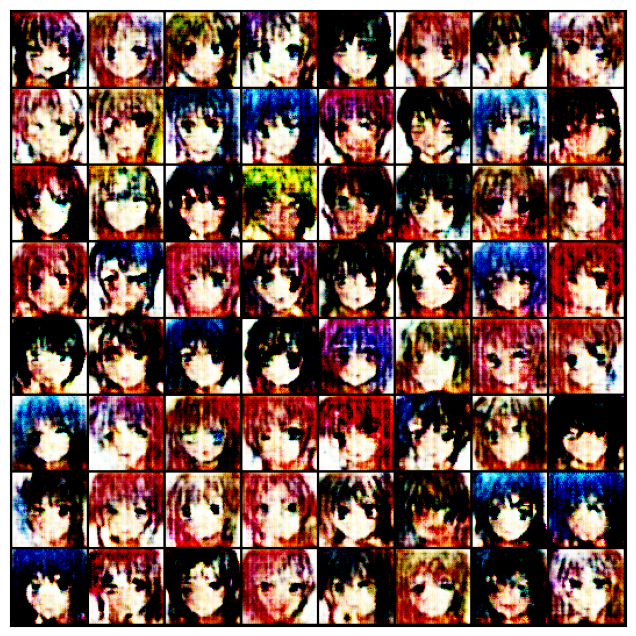

...

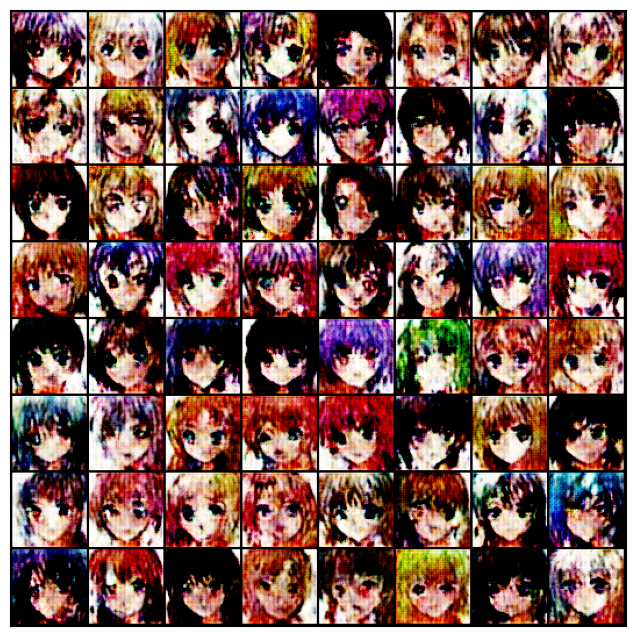

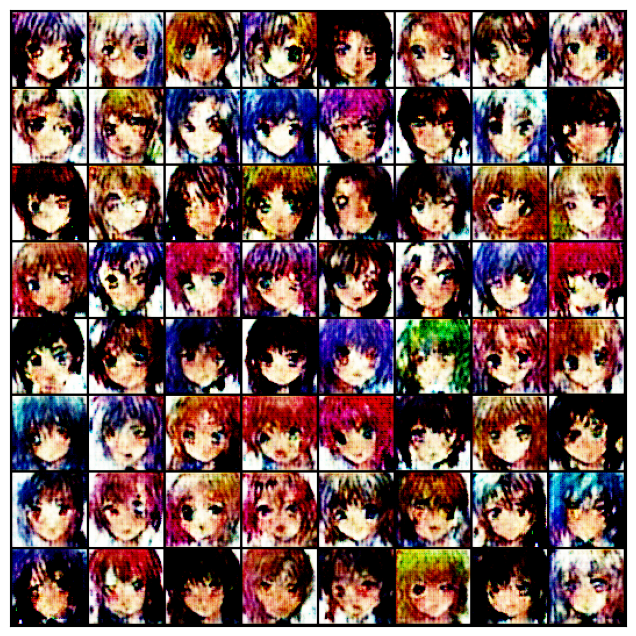

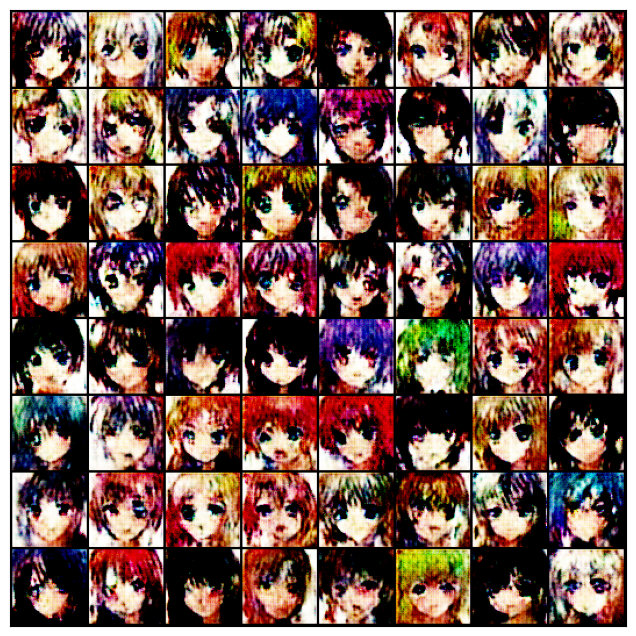

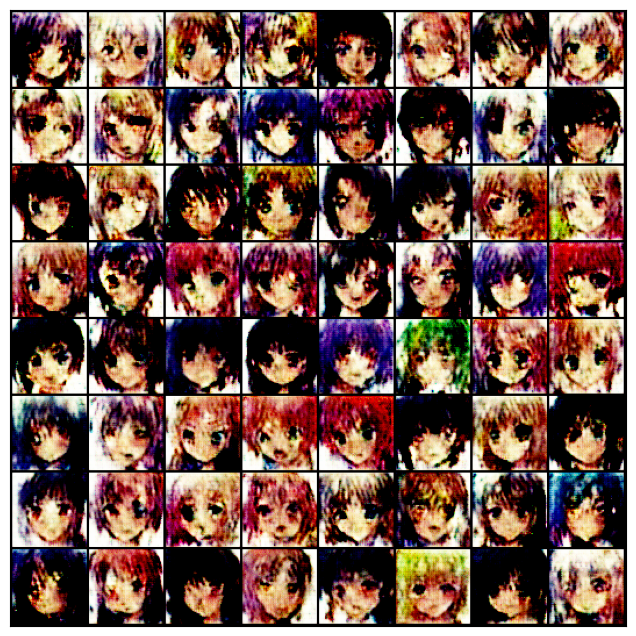

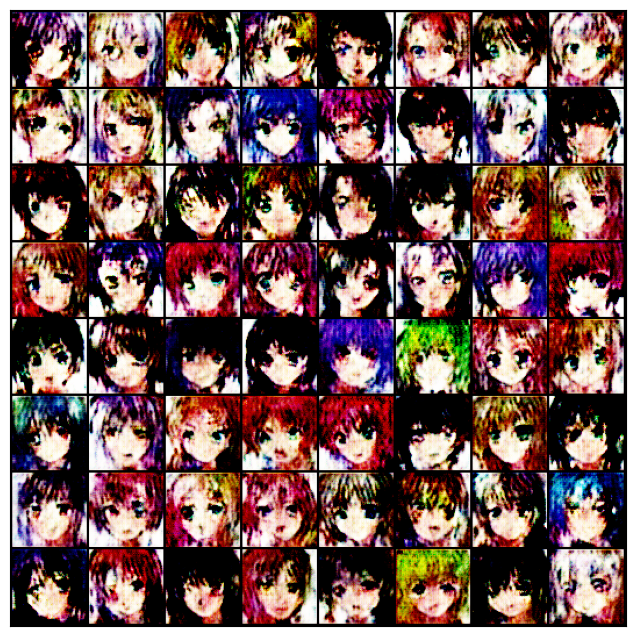

In [18]:
epochs = 25
index = 1
optimizer_d = torch.optim.Adam(params=discriminator.parameters(),
                               lr=0.0001)
optimizer_g = torch.optim.Adam(params=generator.parameters(),
                               lr=0.0001)
loss_fn = nn.BCELoss()

for epoch in range(epochs):
    discriminator_loss, real_score, fake_score = train_discriminator(train_dataloader, latent_space, optimizer_d, loss_fn)
    generator_loss = train_generator(train_dataloader, latent_space, optimizer_g, loss_fn)
    save_images(index+epoch, latent_space)
    print(f'Epoch : {epoch} | discriminator_loss : {discriminator_loss :.3f} | generator_loss : {generator_loss :.3f} | real_score : {real_score :.3f} | fake_score : {fake_score :.3f}')


In [19]:
torch.save(discriminator, '/Users/navalmor/Desktop/deeplearning/model/discriminator.pt')
torch.save(generator, '/Users/navalmor/Desktop/deeplearning/model/generator.pt')

In [20]:
model = torch.load('/Users/navalmor/Desktop/deeplearning/model/generator.pt')
model

Sequential(
  (0): ConvTranspose2d(256, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
  (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (2): ReLU(inplace=True)
  (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
  (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (5): ReLU(inplace=True)
  (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
  (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (8): ReLU(inplace=True)
  (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
  (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (11): ReLU(inplace=True)
  (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
  (13): Tanh()
)

In [1]:
with torch.inference_mode():
    plt.imshow(model(latent).squeeze().permute(1,2,0))

NameError: name 'torch' is not defined